**1. Dada la imagen en el vínculos: **

https://www.strategy-business.com/media/image/43449823_1000x500.jpg


Reconocer aquellas muestras cuya área esté disminuida en un 30% o más, respecto al promedio. Tener en cuenta que hay dos tipos de muestra: 1 y 0.

¿Aplicación para la vida real? Considerar la información presente en:

https://www.mvtec.com/application-areas/success-stories/machine-vision-inspects-biscuits-machine-vision-technology-ltd

https://www.pekatvision.com/blog/case-study-biscuits-and-puffed-rice-bread

In [ ]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
# https://stackoverflow.com/questions/15497308/remove-points-which-contains-pixels-fewer-than-n
from skimage import morphology
# https://stackoverflow.com/questions/55056456/failed-to-remove-noise-by-remove-small-objects
# https://stackoverflow.com/questions/55679936/how-to-do-component-labeling-of-a-binary-image-in-python
from skimage.measure import label
# https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_regionprops.html
from skimage.measure import label, regionprops, regionprops_table
import pandas as pd
from matplotlib import pyplot as plt # this lets you draw inline pictures in the notebooks

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Preprocesamiento

In [ ]:
rgb = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Cookies_numbers.webp',cv2.IMREAD_COLOR)
cv2_imshow(rgb)

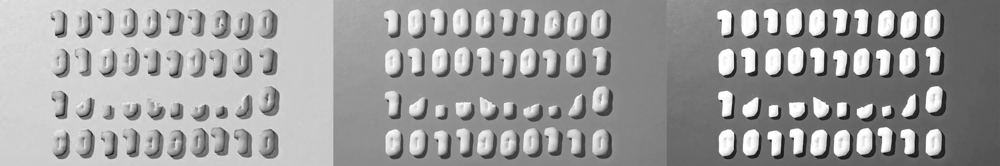

In [ ]:
r = rgb[:,:,0]
g = rgb[:,:,1]
b = rgb[:,:,2]
mosaicRGB = cv2.hconcat((r,g,b))
cv2_imshow(mosaicRGB)

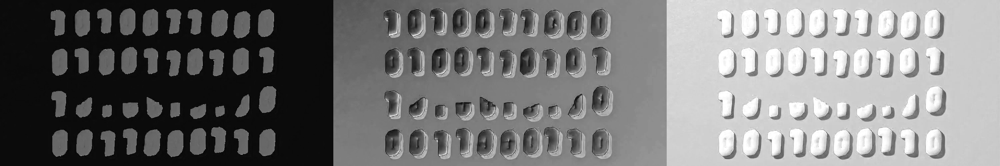

In [ ]:
hsv = cv2.cvtColor(rgb,cv2.COLOR_RGB2HSV) # https://stackoverflow.com/questions/2612361/convert-rgb-values-to-equivalent-hsv-values-using-python

h = hsv[:,:,0]
s = hsv[:,:,1]
v = hsv[:,:,2]
mosaicHSV = cv2.hconcat((h,s,v))
cv2_imshow(mosaicHSV)

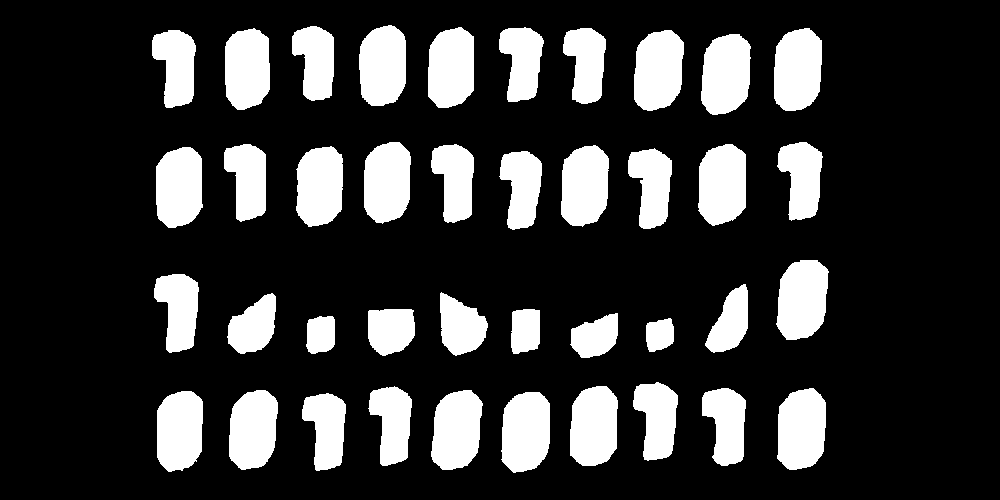

In [ ]:
#Binary format
retH,thr_H = cv2.threshold(h,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
cv2_imshow(thr_H)

In [ ]:
# ¿Cuántos objetos hay en la imagen?
print(np.max(thr_H))

255


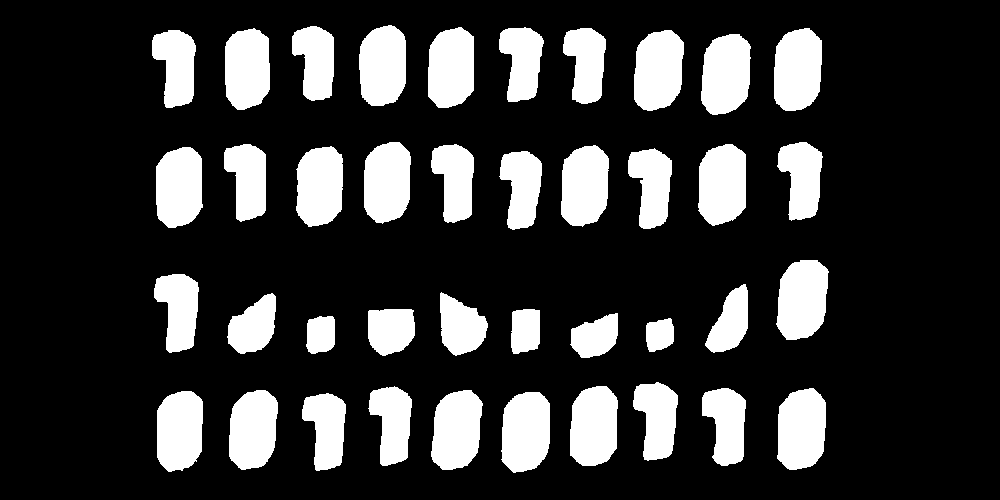

In [ ]:
# Supresión: objetos de menos de X píxeles.
labels1 = label(thr_H)
minSize = 180
pc1 = 1
cleaned1 = morphology.remove_small_objects(labels1, min_size = minSize, connectivity = pc1)
cleaned1[cleaned1 != 0] = 255
cv2_imshow(cleaned1)

In [ ]:
# ¿Cuántos objetos hay en la imagen?
labels2 = label(cleaned1)
print(np.min(labels2))
print(np.max(labels2))

0
40


La detección de forma usando aproximación de contorno ayuda a detectar formas principalmente geométricas. Esta técnica aproxima un contorno a otro con elmenor número de vertices de tal manera que la distancia entre ambas imágenes es menor o igual a una precisión especificada.

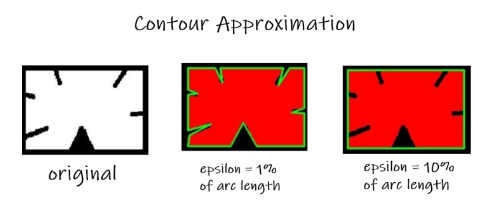

OpenCV nos provee un constructor funcional que permite especificar las curvas de las forma basado en el algoritmo de Douglas-Peucker https://cartography-playground.gitlab.io/playgrounds/douglas-peucker-algorithm/

In [ ]:
import imutils
cnts = cv2.findContours(thr_H.copy(), cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)

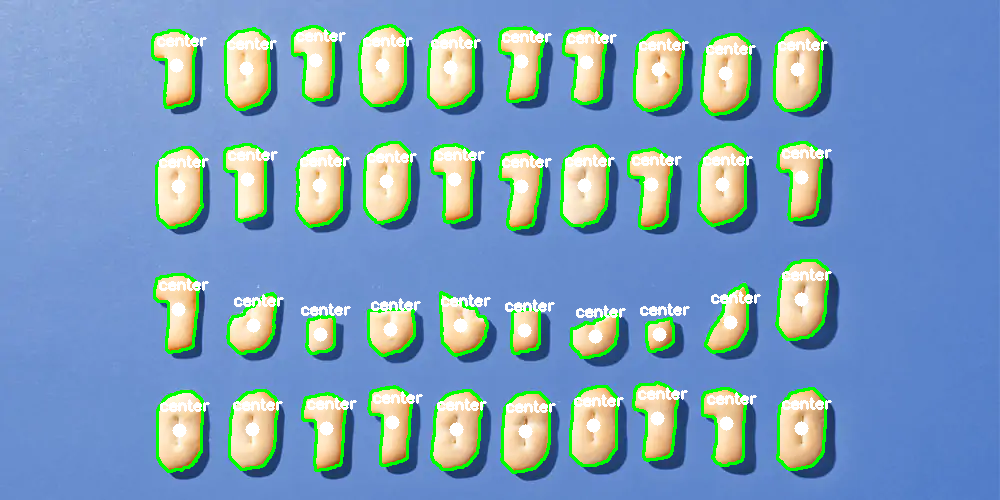

-1

In [ ]:
rgb = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Cookies_numbers.webp',cv2.IMREAD_COLOR)
image = rgb.copy()
# loop over the contours
for c in cnts:
	# compute the center of the contour
	M = cv2.moments(c)
	cX = int(M["m10"] / M["m00"])
	cY = int(M["m01"] / M["m00"])
	# draw the contour and center of the shape on the image
	cv2.drawContours(image, [c], -1, (0, 255, 0), 2)
	cv2.circle(image, (cX, cY), 7, (255, 255, 255), -1)
	cv2.putText(image, "center", (cX - 20, cY - 20),
		cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
	# show the image
cv2_imshow(image)
cv2.waitKey(0)

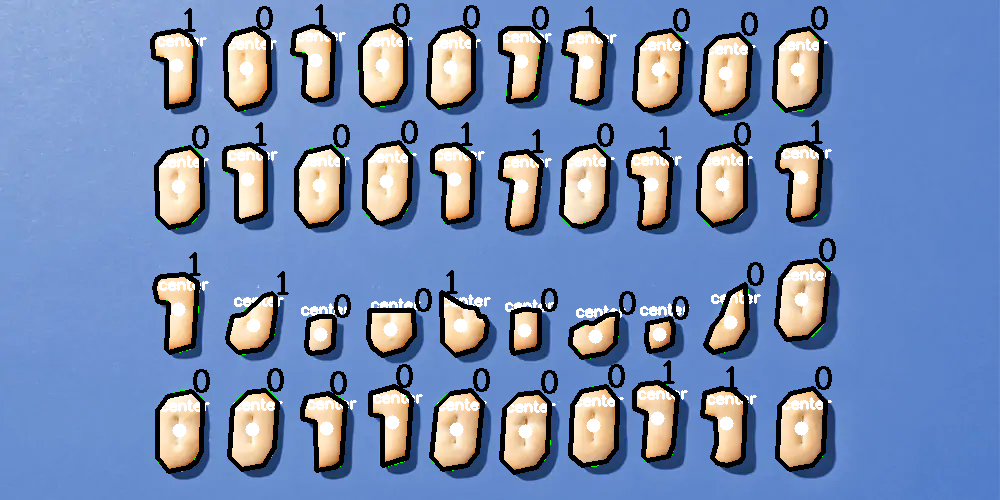

-1

In [ ]:
#Contour aproximation
for cnt in cnts:
    epsilon = 0.01*cv2.arcLength(cnt, True)
    approx = cv2.approxPolyDP(cnt, epsilon, True)
    area = cv2.contourArea(cnt)
    cv2.drawContours(image, [approx], 0, (0), 3)
    # Position for writing text
    x,y = approx[0][0]

    if 5 < len(approx) < 10:
        cv2.putText(image, "0", (x, y), cv2.FONT_HERSHEY_COMPLEX, 1, 0,2)
    else:
        cv2.putText(image, "1", (x, y), cv2.FONT_HERSHEY_COMPLEX, 1, 0,2)
cv2_imshow(image)
cv2.waitKey(0)

Trabajando en un dataframe

In [ ]:
conts=pd.DataFrame(cnts,columns =['Data'])

/usr/local/lib/python3.7/dist-packages/pandas/core/internals/construction.py:540: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  values = np.array([convert(v) for v in values])


In [ ]:
#Segmentando y hallando area
conts['muestra']="1"
conts['area']=0
for i in conts.index:
  epsilon = 0.01*cv2.arcLength(conts['Data'][i], True)
  approx = cv2.approxPolyDP(conts['Data'][i], epsilon, True)
  area = cv2.contourArea(conts['Data'][i])
  conts.iloc[i,2]=area
  if 5 < len(approx) < 10:
    conts.iloc[i,1]="0"
conts

,Data,muestra,area
0,"[[[326, 393]], [[325, 394]], [[319, 394]], [[3...",0,2293.0
1,"[[[525, 392]], [[524, 393]], [[523, 393]], [[5...",0,3236.5
2,"[[[181, 391]], [[180, 392]], [[177, 392]], [[1...",0,3106.5
3,"[[[463, 390]], [[462, 391]], [[458, 391]], [[4...",0,3188.5
4,"[[[256, 390]], [[255, 391]], [[254, 391]], [[2...",0,3115.0
5,"[[[809, 388]], [[808, 389]], [[804, 389]], [[8...",0,3261.0
6,"[[[721, 388]], [[720, 389]], [[717, 389]], [[7...",1,2369.0
7,"[[[596, 386]], [[595, 387]], [[592, 387]], [[5...",0,3173.0
8,"[[[394, 386]], [[393, 387]], [[389, 387]], [[3...",0,2309.5
9,"[[[656, 382]], [[654, 384]], [[640, 384]], [[6...",1,2401.0


In [ ]:
#Segmentado
from statistics import mean
meanmuestra0=mean(conts[conts['muestra']=="0"]['area'])
meanmuestra1=mean(conts[conts['muestra']=="1"]['area'])
conts['area_meno30_seg']="<30"

for i in conts.index:
  if conts.iloc[i]['muestra']=="1":
    if conts.iloc[i]['area']>=meanmuestra1*0.3:
      conts.iloc[i,3]=">30"
  else:
    if conts.iloc[i]['area']>=meanmuestra0*0.3:
      conts.iloc[i,3]=">30"
conts

,Data,muestra,area,area_meno30_seg
0,"[[[326, 393]], [[325, 394]], [[319, 394]], [[3...",0,2293.0,>30
1,"[[[525, 392]], [[524, 393]], [[523, 393]], [[5...",0,3236.5,>30
2,"[[[181, 391]], [[180, 392]], [[177, 392]], [[1...",0,3106.5,>30
3,"[[[463, 390]], [[462, 391]], [[458, 391]], [[4...",0,3188.5,>30
4,"[[[256, 390]], [[255, 391]], [[254, 391]], [[2...",0,3115.0,>30
5,"[[[809, 388]], [[808, 389]], [[804, 389]], [[8...",0,3261.0,>30
6,"[[[721, 388]], [[720, 389]], [[717, 389]], [[7...",1,2369.0,>30
7,"[[[596, 386]], [[595, 387]], [[592, 387]], [[5...",0,3173.0,>30
8,"[[[394, 386]], [[393, 387]], [[389, 387]], [[3...",0,2309.5,>30
9,"[[[656, 382]], [[654, 384]], [[640, 384]], [[6...",1,2401.0,>30


Show imagen con las muestras con mejor a 30% del promedio del área

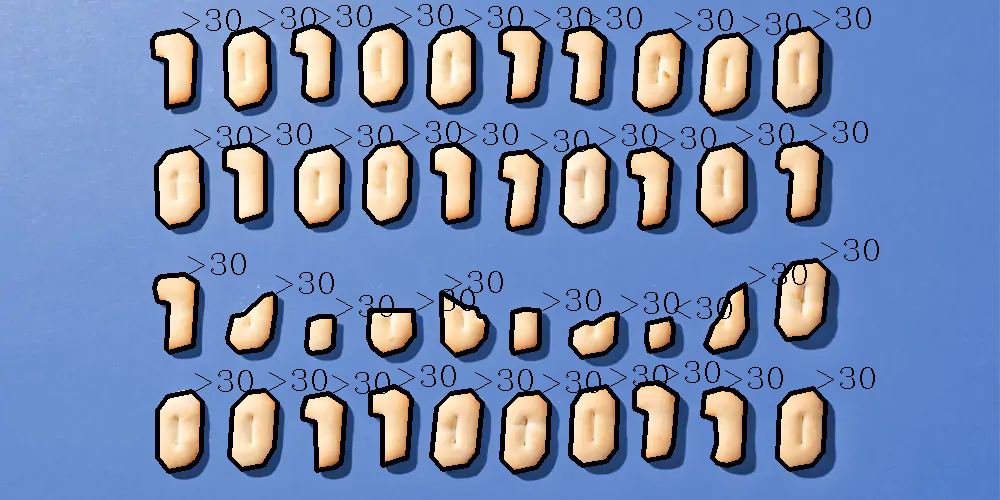

-1

In [ ]:
rgb = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Cookies_numbers.webp',cv2.IMREAD_COLOR)
image = rgb.copy()
for i in conts.index:
    epsilon = 0.01*cv2.arcLength(conts['Data'][i], True)
    approx = cv2.approxPolyDP(conts['Data'][i], epsilon, True)
    cv2.drawContours(image, [approx], 0, (0), 3)
    # Position for writing text
    x,y = approx[0][0]
    label=conts.iloc[i,3]
    cv2.putText(image, label, (x, y), cv2.FONT_HERSHEY_COMPLEX, 1, 0,1)
cv2_imshow(image)
cv2.waitKey(0)

El método utilizado para la detección de forma nos ha permitido clasificar las imágenes con un alto grado de acertación, además nos ha permitido calcular el área para identificar aquellas imágenes con menos de 30% del área original a partir de aproximación de contornos.

Esto se usa ampliamente en robótica para la clasificación de patrones y el análisis de escenas.

**2. En la imagen Tiles1.jpg, reconocer vía clustering los fragmentos de cerámica que no tienen fracturas en su interior, los que si tienen, y los de color azul.**

https://stackoverflow.com/questions/61979855/changing-colours-of-an-area-in-an-image-using-opencv-in-python

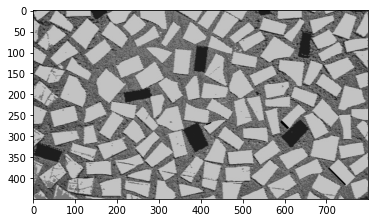

In [ ]:
imagenEnt = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Tiles1.jpg',cv2.IMREAD_COLOR)
imagenEnt = cv2.cvtColor(imagenEnt, cv2.COLOR_BGR2RGB) # OpenCV usa el ordenamiento BGR por defecto, mientras que matplotlib asume RGB.
plotInputIm = plt.imshow(imagenEnt)

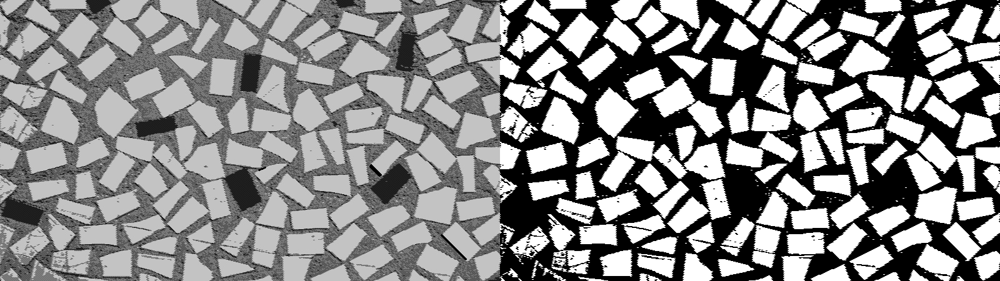

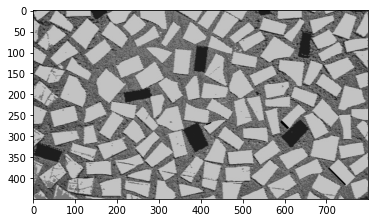

In [ ]:
# Se debe conectar con el Drive, y luego buscar la ruta correcta para leer la imagen
imagenEnt = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Tiles1.jpg',cv2.IMREAD_COLOR)
imagenEnt = cv2.cvtColor(imagenEnt, cv2.COLOR_BGR2RGB) # OpenCV usa el ordenamiento BGR por defecto, mientras que matplotlib asume RGB.
plotInputIm = plt.imshow(imagenEnt)

imagenEnt = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Tiles1.jpg',cv2.IMREAD_GRAYSCALE)
# Enfoque 1: convertir la imagen a una equivalente en escala de grises, y umbralizar con el método de Otsu.
ret2,thresholded = cv2.threshold(imagenEnt,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
mosaicHSV = cv2.hconcat((imagenEnt,thresholded))
cv2_imshow(mosaicHSV)

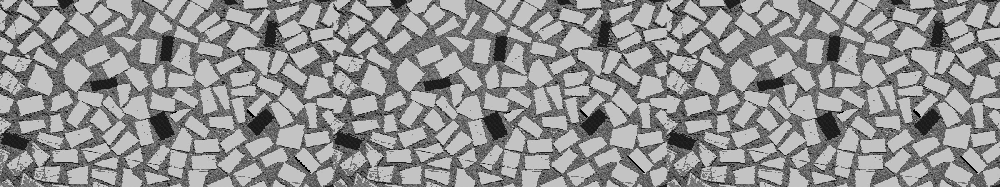

In [ ]:
# Enfoque 2: separar las tres componentes de color en espacio RGB.
RGB = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Tiles1.jpg',cv2.IMREAD_COLOR)
RGB  = cv2.cvtColor(RGB, cv2.COLOR_BGR2RGB) # OpenCV usa el ordenamiento BGR por defecto, mientras que matplotlib asume RGB.

R = RGB[:,:,0]
G = RGB[:,:,1]
B = RGB[:,:,2]
mosaicHSV = cv2.hconcat((R,G,B))
cv2_imshow(mosaicHSV)

Text(0.5, 1.0, 'Thresholded image - B color channel.')

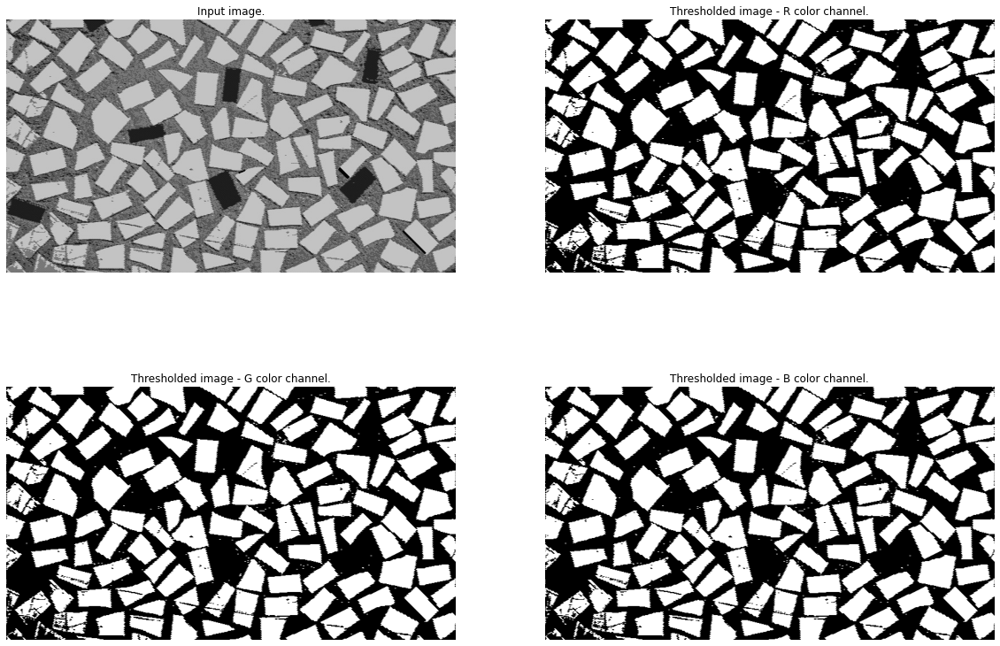

In [ ]:
# Uumbralizar cada componente de color del espacio RGB con el método de Otsu.

# Otsu's thresholding
retR,thrR = cv2.threshold(R,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
retR,thrG = cv2.threshold(G,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
retR,thrB = cv2.threshold(B,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
# plotInputIm = plt.imshow(thresholded,cmap = 'gray')

# Creando figura
fig = plt.figure(figsize=(20, 14))

# seteando filas y columnas
rows = 2
columns = 2
fig.add_subplot(rows, columns, 1)
plt.imshow(RGB)
plt.axis('off')
plt.title('Input image.')


fig.add_subplot(rows,columns,2)
plt.imshow(thrR,cmap='gray')
plt.axis('off')
plt.title('Thresholded image - R color channel.')


fig.add_subplot(rows,columns,3)
plt.imshow(thrG,cmap='gray')
plt.axis('off')
plt.title('Thresholded image - G color channel.')


fig.add_subplot(rows, columns, 4)
plt.imshow(thrG,cmap='gray')
plt.axis('off')
plt.title('Thresholded image - B color channel.')

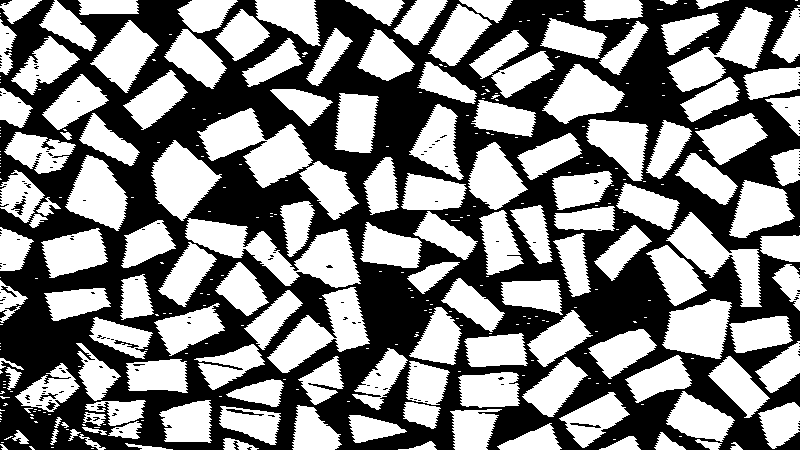

In [ ]:
#Binary format
retH,thr_H = cv2.threshold(R,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
cv2_imshow(thr_H)

Teniendo en cuenta que tenemos varias imágenes a segmentar el formato binario distorciona la imágen, para aplicaciones que tienen más que un contorno para clasificar es mejor trabajar otro tipo de formatos. Este es útil para identificar las grietas, pero hace que los azulejos azules se pierdan en el fondo. Ademas mirar una manera de eliminar el ruido del fondo

In [ ]:
# ¿Cuántos objetos hay en la imagen?
print(np.min(thr_H))
print(np.max(thr_H))

0
255


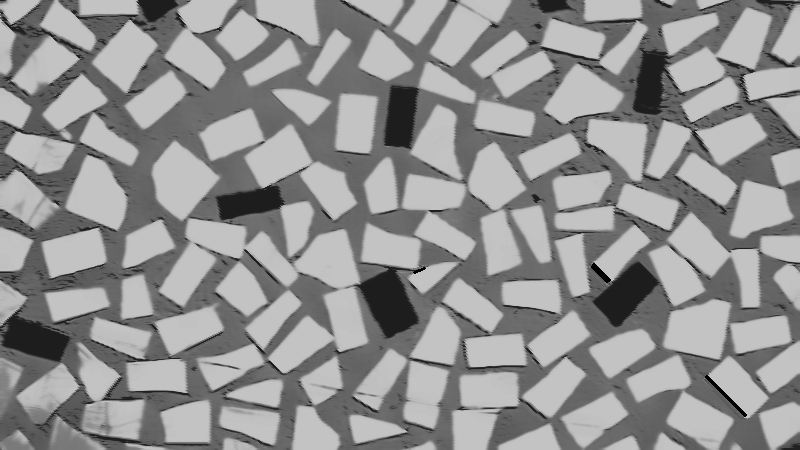

In [ ]:
#Eliminando ruido
image = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Tiles1.jpg',1)
image_bw = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Tiles1.jpg',0)

noiseless_image_bw = cv2.fastNlMeansDenoising(image_bw, None, 20, 7, 21)
noiseless_image_colored = cv2.fastNlMeansDenoisingColored(image,None,20,20,7,21)

cv2_imshow(noiseless_image_colored)

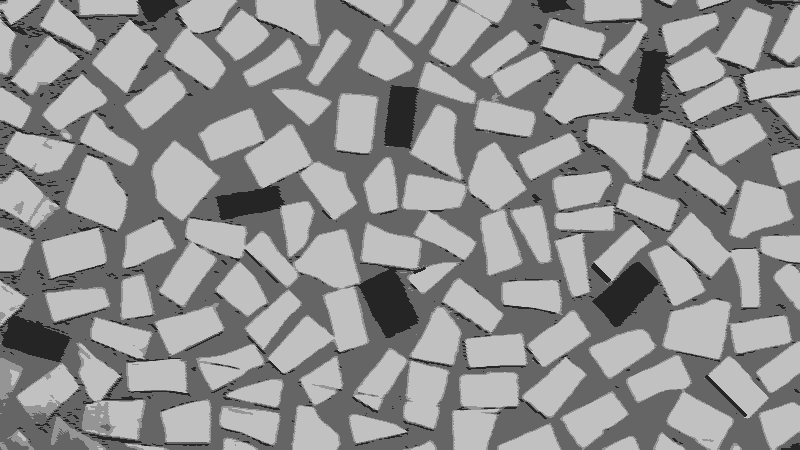

In [ ]:
# estamos aplanando la imagen, volviéndola un vector de puntos en un espacio 3D.
pixel_values = noiseless_image_colored.reshape((-1, 3))
pixel_values = np.float32(pixel_values)

# Definimos el criterio de terminación del algoritmo. En este caso, terminaremos cuando la última actualización de los
# centroides sea menor a *epsilon* (cv2.TERM_CRITERIA_EPS), donde epsilon es 1.0 (último elemento de la tupla), o bien cuando se hayan completado 10 iteraciones
stop_criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)

# Este es el número de veces que se correrá K-Means con diferentes inicializaciones. La función retornará los mejores
# resultados.
number_of_attempts = 10

# Esta es la estrategia para inicializar los centroides. En este caso, optamos por inicialización aleatoria.
centroid_initialization_strategy = cv2.KMEANS_RANDOM_CENTERS

# El algoritmo retorna las siguientes salidas:
# - Un arreglo con la distancia de cada punto a su centroide. Aquí lo ignoramos.
# - Arreglo de etiquetas.
# - Arreglo de centroides.
_, labels, centers = cv2.kmeans(pixel_values,
                                4,
                                None,
                                stop_criteria,
                                number_of_attempts,
                                centroid_initialization_strategy)

# Aplicamos las etiquetas a los centroides para segmentar los pixeles en su grupo correspondiente.
centers = np.uint8(centers)
segmented_data = centers[labels.flatten()]

# Debemos reestructurar el arreglo de datos segmentados con las dimensiones de la imagen original.
segmented_image = segmented_data.reshape(noiseless_image_colored.shape)

# Mostramos la imagen segmentada resultante.
cv2_imshow(segmented_image)

El método de clustering es efectivo sin embargo el ruido de fondo distorciona los resultados si requerimos pasar la imágen por otro descriptor como el filtro de canny. Por ello antes de la segmentación de ser necesario es importante eliminar el ruido que contiene la imágen en su interior, por ello, se decidió manejar capas de información por medio de la eliminación de ruido y la extracción de información de color:

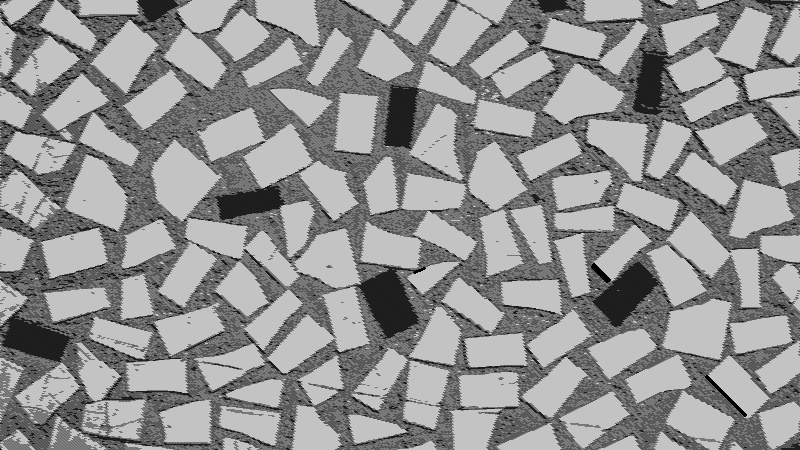

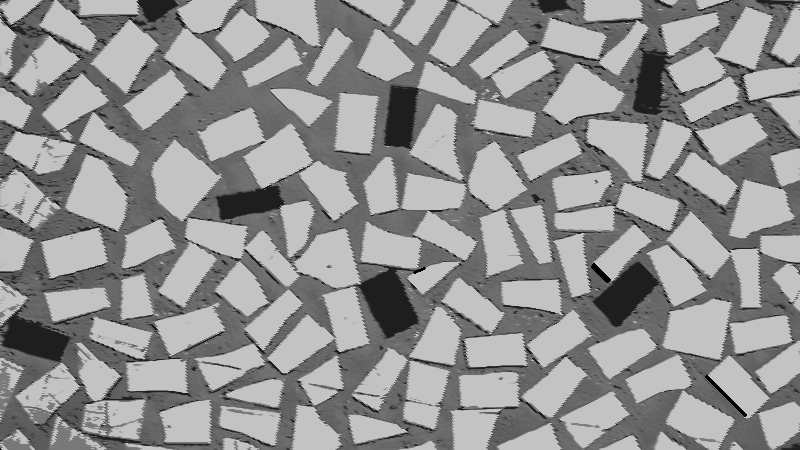

In [ ]:
imageTiles = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Tiles1.jpg')
imagecopy = imageTiles.copy()

cv2_imshow(imageTiles)
#noiseless_image_bw = cv2.fastNlMeansDenoising(imageTiles, None, 20, 7, 21) 20 Fuerza del filtro , 7 el tamaño de la ventana de la plantilla .21 el tamaño de la ventana del área de búsqueda
noiseless_image_bw = cv2.fastNlMeansDenoising(imageTiles, None, 20, 5, 17)
#noiseless_image_bw = cv2.medianBlur(imageTiles, 3) #RECOMIENDAN BLUR PARA AYUDAR A DISMINUTIR LA CANTIDAD DE VARIACION DE COLORES
cv2_imshow(noiseless_image_bw)

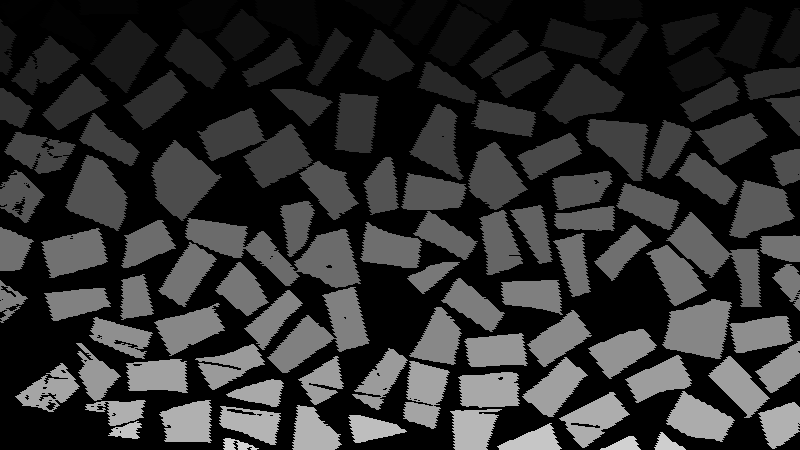

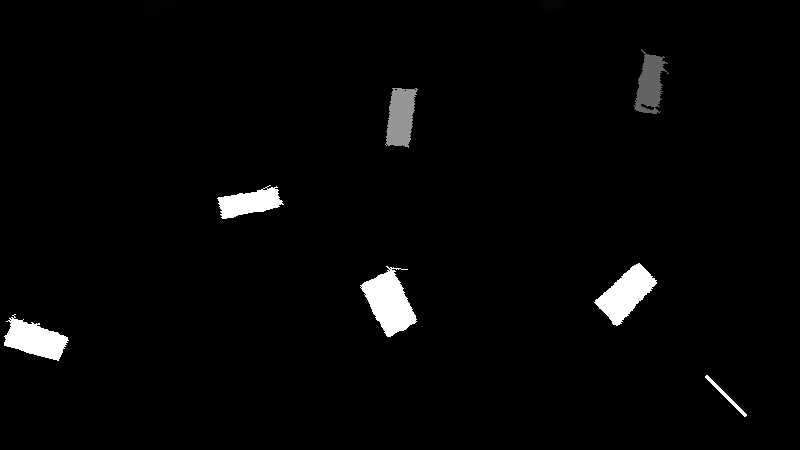

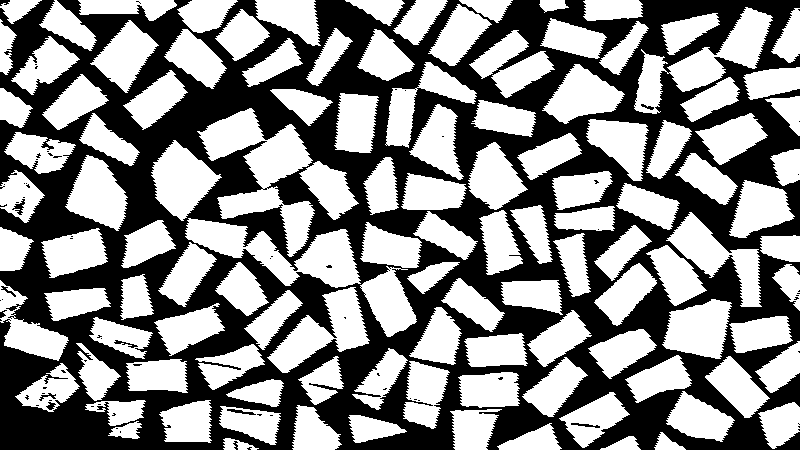

In [ ]:
#Estraer información de la imágen
# cv2.COLOR_BGR2HSV(HVR 3 DIMENSIONES) cv2.COLOR_GRAY2BGR (GRIS 2 DIMENSIONES)
hsv=cv2.cvtColor(noiseless_image_bw,cv2.COLOR_BGR2HSV)

sensitivity_white = 90
lower_white = np.array([0, 0, 255 - sensitivity_white])
upper_white = np.array([255, sensitivity_white, 255])

lower_black = np.array([0, 0,0])
upper_black = np.array([255, 255, 32])

# Crrear una mascara solo para seleccionar el blanco
mask_white = cv2.inRange(hsv, lower_white, upper_white)
mask_black = cv2.inRange(hsv, lower_black, upper_black)

#parametros de piezas permitidas
minSize = 200
pc1 = 1

label_white = label(mask_white)
label_black = label(mask_black)

cleanedBlack = morphology.remove_small_objects(label_white, min_size = minSize, connectivity = pc1)
cleanedWhite = morphology.remove_small_objects(label_black, min_size = minSize, connectivity = pc1)

cleanedResult = 255*(cleanedBlack + cleanedWhite)  #https://stackoverflow.com/questions/58687463/how-to-add-multiple-binary-masks
cleanedResult = cleanedResult.clip(0, 255).astype("uint8")

cv2_imshow(cleanedBlack)
cv2_imshow(cleanedWhite)
cv2_imshow(cleanedResult)

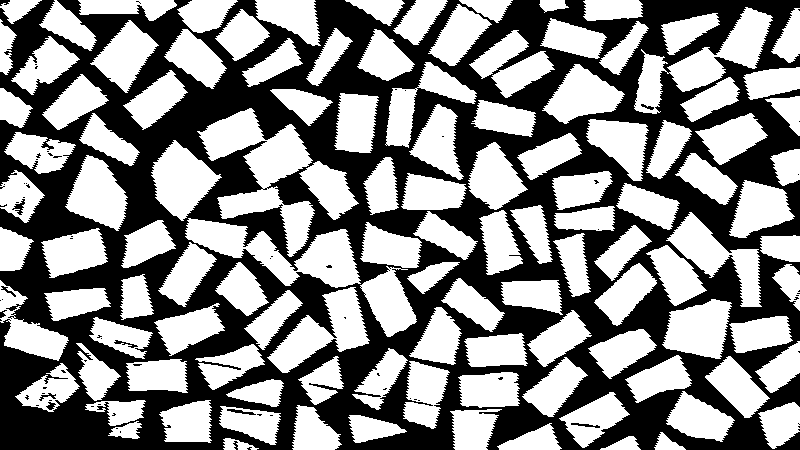

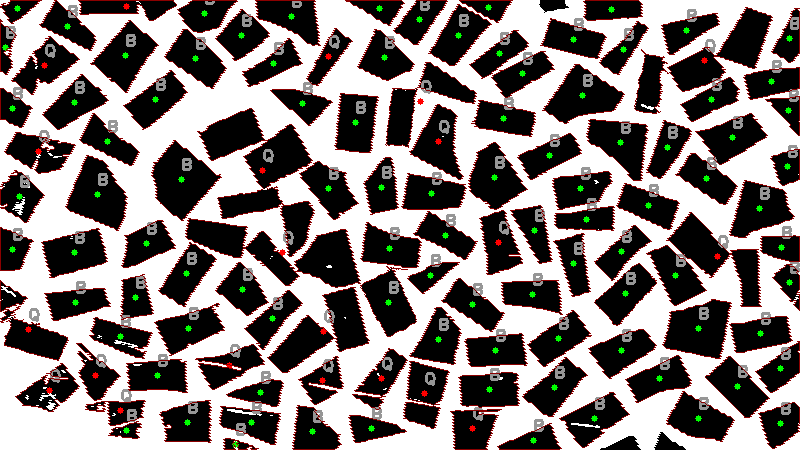

In [ ]:
#https://stackoverflow.com/questions/61979855/changing-colours-of-an-area-in-an-image-using-opencv-in-python
#PARA MANIPULAR REALMENTE LA IMAGEN

#ret, thresh = cv.threshold(imgray, 127, 255, 0)
imagecopy=imageTiles.copy();
imagecopy[cleanedResult == 0] = (0, 0,0)
imagecopy[cleanedResult > 0] = (255, 255,255)
imagecopy=np.invert(imagecopy)

#cv2_imshow(imagecopy)
#parametros de piezas permitidas PENDIENTE
minSize = 200
pc1 = 1
label_final = label(imagecopy)
mku = morphology.remove_small_objects(label_white, min_size = minSize, connectivity = pc1)
#cv2_imshow(mku)

#CONTORNOS https://docs.opencv.org/4.x/dd/d49/tutorial_py_contour_features.html
_, threshold = cv2.threshold(imagecopy, 70, 255, cv2.THRESH_BINARY_INV)
gray_image = cv2.cvtColor(threshold, cv2.COLOR_BGR2GRAY)
cv2_imshow(threshold)
contours, hierarchy = cv2.findContours(gray_image,cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

tolerancia_perimetro=100
#TEST Mas baldosas pero mas margen de error
"""
tolerancia_perimetro=70
imagecopy=cv2.drawContours(imagecopy, contours, -1, (255, 255, 255),1)
_, threshold = cv2.threshold(imagecopy, 70, 255, cv2.THRESH_BINARY_INV)
gray_image = cv2.cvtColor(threshold, cv2.COLOR_BGR2GRAY)
cv2_imshow(threshold)
contours, hierarchy = cv2.findContours(gray_image,cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
"""

for c in contours:
  try:
    # compute the center of the contour
    M = cv2.moments(c)
    cX = int(M["m10"] / M["m00"])
    cY = int(M["m01"] / M["m00"])
    area = cv2.contourArea(c)
    perímetroReal = cv2.arcLength (c, True )
    if(perímetroReal>100):
      perimetroTeorico=np.sqrt(area)*4
      if((perimetroTeorico+tolerancia_perimetro)< perímetroReal ):
        cv2.circle(imagecopy, (cX, cY), 3, (0, 0, 255), -1)
        cv2.putText(imagecopy, "Q", (cX , cY - 10),
          cv2.FONT_HERSHEY_SIMPLEX, 0.5, (150, 150, 150), 2)
      else:
        cv2.circle(imagecopy, (cX, cY), 3, (0, 255,0 ), -1)
        cv2.putText(imagecopy, "B", (cX , cY - 10),
          cv2.FONT_HERSHEY_SIMPLEX, 0.5, (150, 150, 150), 2)

      cv2.drawContours(imagecopy, [c], -1, (0, 0, 140), 1)
  except:
    print("An exception occurred")
	# dibujar el contorno ycentro de la imágen
cv2_imshow(imagecopy)

#imgg=cv2.drawContours(imagecopy, contours, -1, (153, 15, 57),1)
#cv2_imshow(imgg)


Con este ejercicio se pudo identificar la importancia de eliminar el ruido de fondo de la imágen para poder extraer las características necesarias de la imágen por medio del análisis de contornos con el perimetro de la imágen para identificar si una baldoza estaba quebrada y los colores se identificaron por medio de los filtros de color

**3. En la imagen Cells1.jpg, reconocer las células que tengan la ROI que luce de color violeta en las imágenes, y por lo menos 3 clases de célula, considerando información de forma.**

Se aplicó el método de disminución de ruido para luego jugar con las capas de color y perímetro/área de la célula para identificar los distintos tipos de células

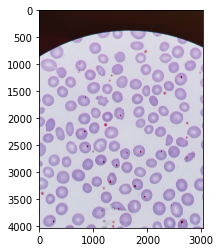

In [ ]:
imagecells = cv2.imread('/content/drive/MyDrive/Tarea_Vision artificial/Cells1.jpg')
imageCellsFinal= imagecells.copy()
noiseless_image_bw = cv2.fastNlMeansDenoising(imagecells, None, 20, 5, 17)
plt.imshow(noiseless_image_bw)

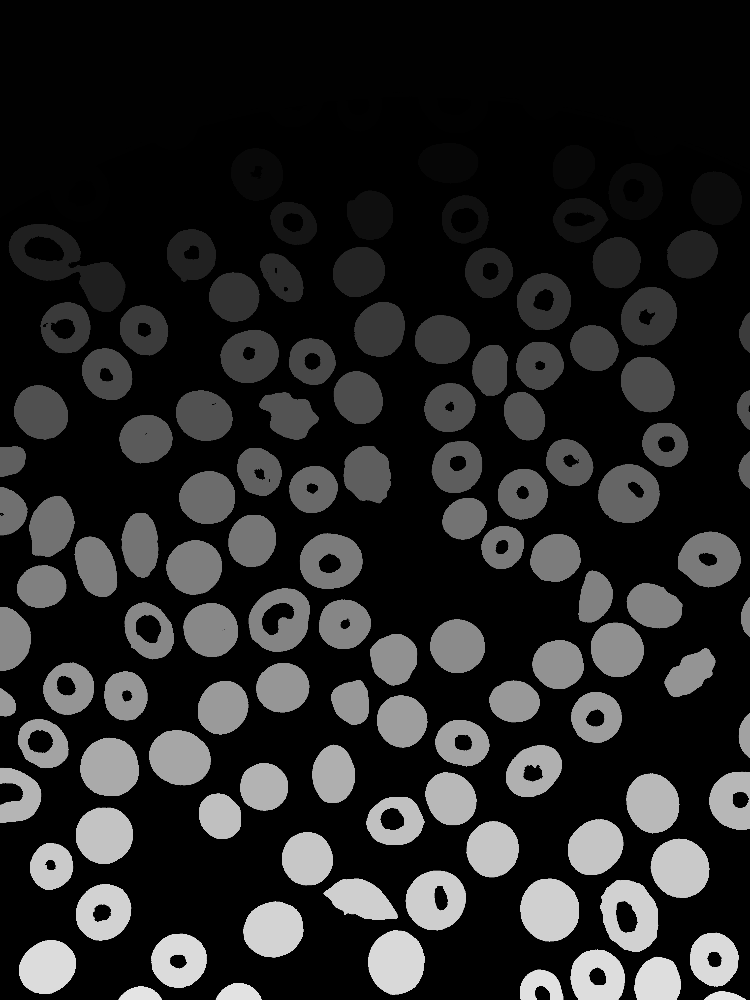

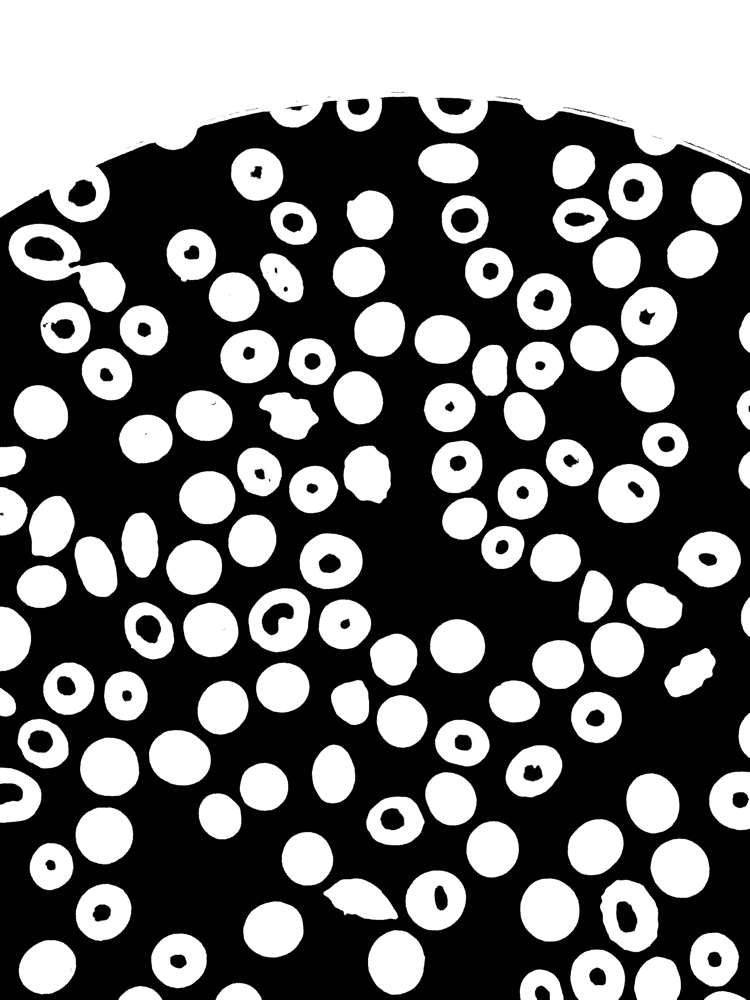

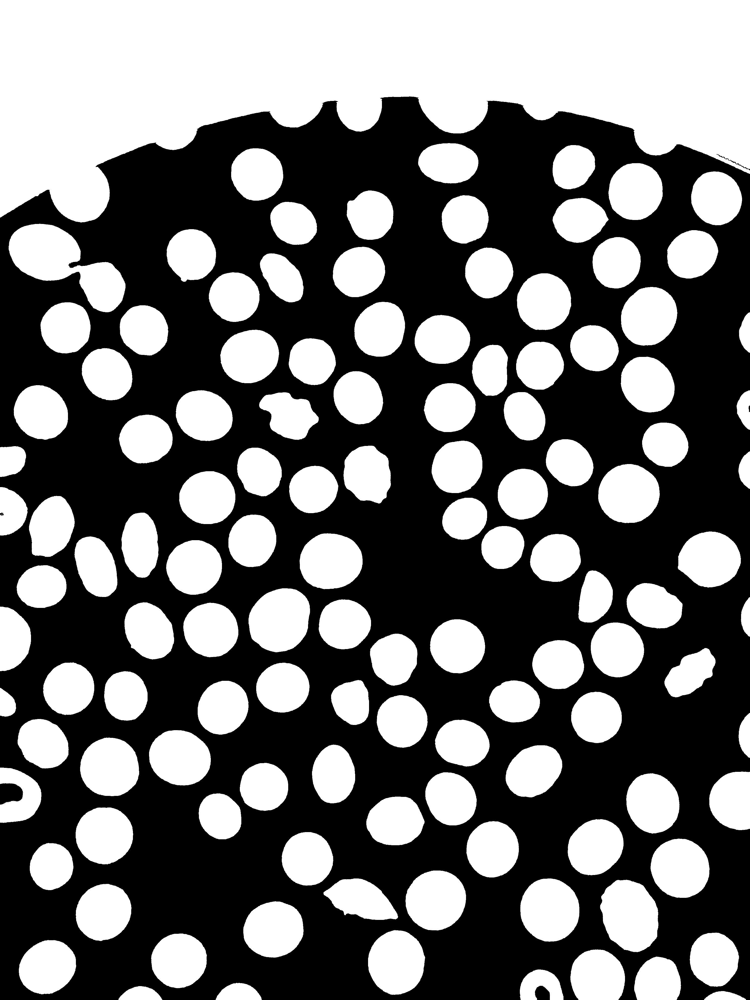

In [ ]:
# cv2.COLOR_BGR2HSV(HVR 3 DIMENSIONES) cv2.COLOR_GRAY2BGR (GRIS 2 DIMENSIONES)
hsv=cv2.cvtColor(noiseless_image_bw,cv2.COLOR_BGR2HSV)

#space mask
h = hsv[:,:,0]
s = hsv[:,:,1]
v = hsv[:,:,2]
mosaicHSV = cv2.hconcat((h,s,v))
#cv2_imshow(mosaicHSV)           #Busqueda de el mejor contraste para utilizar (S) es el mejor

_, binarycellMask = cv2.threshold(s, 40, 255, cv2.THRESH_BINARY) #conversion a imagen binaria para limpieza
#cv2_imshow(threshold)

#Limpieza de "basura" detalles pequeños
minSize = 3500   #en pixeles
pc1 = 1
label_cellsMask = label(binarycellMask)        #tipo de estructura que facilita la lectura de pixeles continuos
cellsMask = morphology.remove_small_objects(label_cellsMask, min_size = minSize, connectivity = pc1)
cv2_imshow(cellsMask)

#Mascara de celulas binarias limpias
cellsMaskClean=noiseless_image_bw.copy();
cellsMaskClean[cellsMask == 0] = (0, 0,0)
cellsMaskClean[cellsMask > 0] = (255, 255,255)
cellsMaskClean=np.invert(cellsMaskClean)

#limpieza de suciedad interior de las celulas
_, cleanBinaryCellMask = cv2.threshold(cellsMaskClean, 70, 255, cv2.THRESH_BINARY_INV) #conversion a imagen binaria para extraer contornos
gray_image = cv2.cvtColor(cleanBinaryCellMask, cv2.COLOR_BGR2GRAY)                      #Conversion a escala de grises
cv2_imshow(cleanBinaryCellMask)
contours, hierarchy = cv2.findContours(gray_image,cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)#extraer contornos

#mascara de celulas limpias
cellsResult = 255*(cellsMask)
cellsResult = cellsResult.clip(0, 255).astype("uint8")

for cnt in contours:
    cv2.drawContours(cellsResult,[cnt],0,255,-1)    #Rellenar celulas, se dejan limpias las celulas por dentro

cv2_imshow((cellsResult))

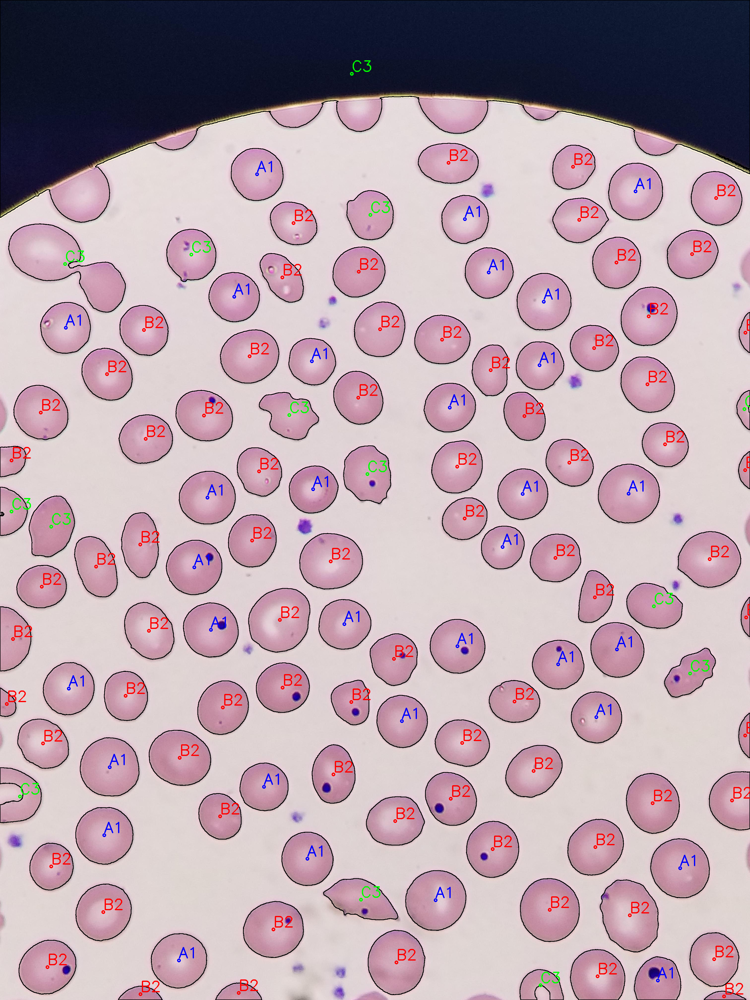

In [ ]:
imageCellsFinal= imagecells.copy()
contoursCells, hierarchy = cv2.findContours(cellsResult,cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
tolerance_circle=14   #Tolerancia para tomarse como una celula A1 (+admite ovaladas,- mas circulares)
for cnt in contoursCells:
    cv2.drawContours(imageCellsFinal,[cnt],0,(0, 0, 0),2)

    approx = cv2.approxPolyDP(                          #Disminucion de vertices para llegar a una forma mas clara
        cnt, 0.007 * cv2.arcLength(cnt, True), True)

    M = cv2.moments(cnt)
    if M['m00'] != 0.0:
        x = int(M['m10']/M['m00'])
        y = int(M['m01']/M['m00'])

    k=cv2.isContourConvex(approx)   #Filtro de circulos (celulas )
    if k:
        _,(MAcir,macir),_ = cv2.fitEllipse (cnt)
        if(abs(abs(MAcir)-abs(macir))<tolerance_circle):
          cv2.putText(imageCellsFinal, 'A1', (x, y-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 3)
          cv2.circle(imageCellsFinal, (x, y), 5, (255, 0,0 ), 3)
        else:
          cv2.putText(imageCellsFinal, 'B2', (x, y-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 2, (0, 0, 255), 3)
          cv2.circle(imageCellsFinal, (x, y), 5, (0, 0,255 ), 3)
    else:
        cv2.putText(imageCellsFinal, 'C3', (x, y-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 2, (0, 255, 0), 3)
        cv2.circle(imageCellsFinal, (x, y), 5, (0, 255,0 ), 3)


cv2_imshow((imageCellsFinal))

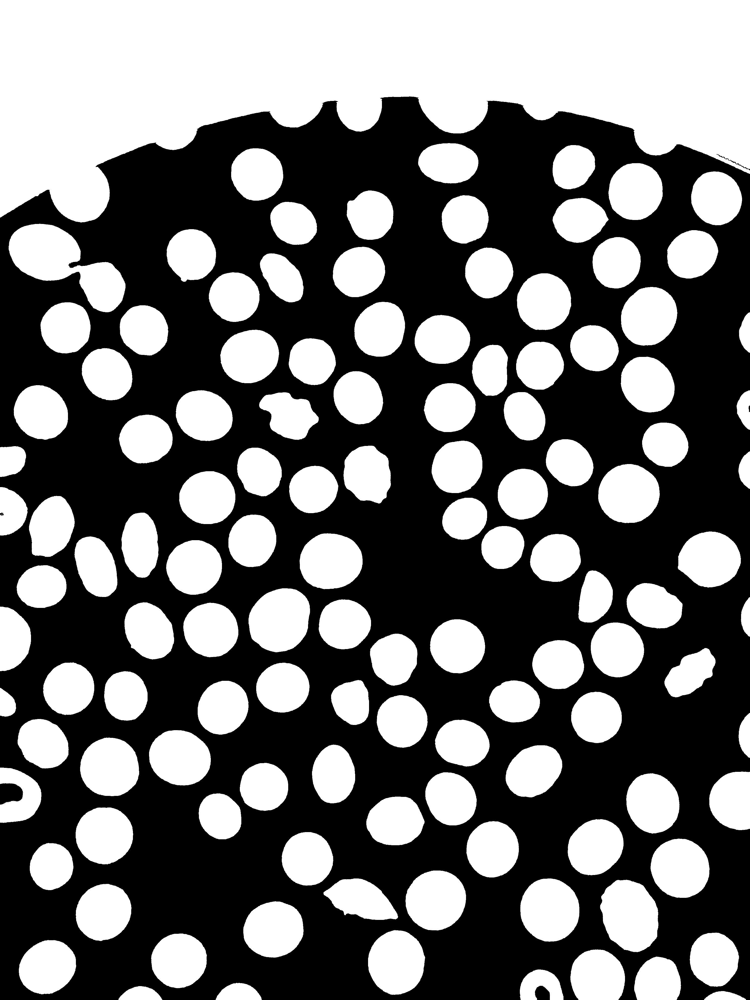

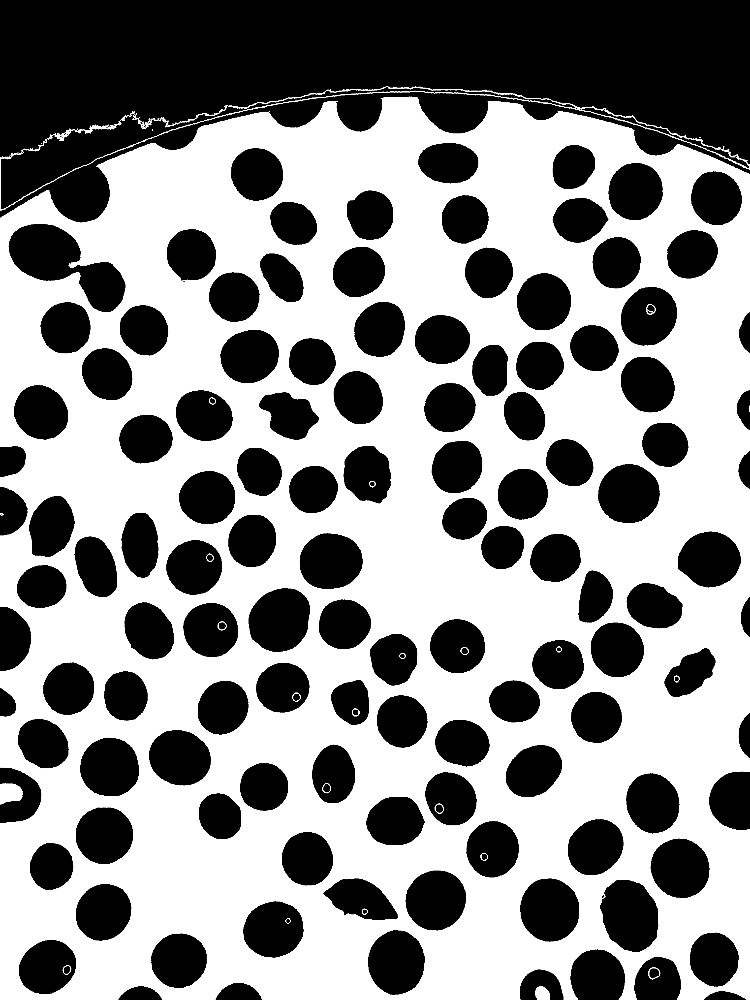

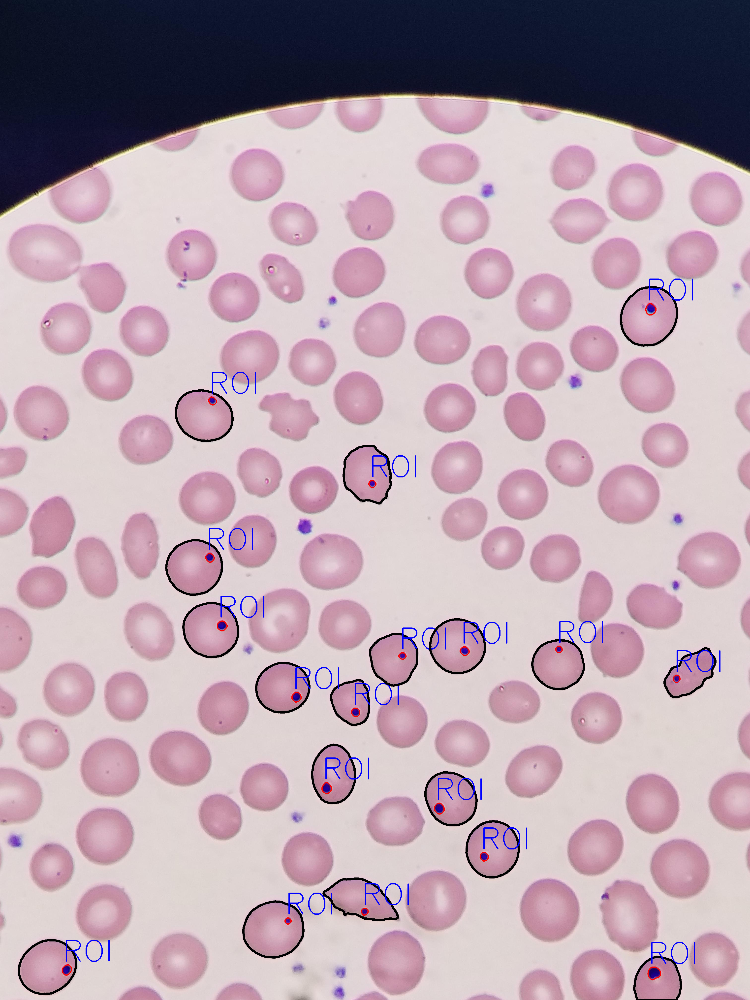

In [ ]:

imageCellsFinal= imagecells.copy()

# cv2.COLOR_BGR2HSV(HVR 3 DIMENSIONES) cv2.COLOR_GRAY2BGR (GRIS 2 DIMENSIONES)
hsv_purple=cv2.cvtColor(noiseless_image_bw,cv2.COLOR_BGR2HSV)
mask_final_purple=np.invert(cellsResult.copy())

#filtro de color morado hsv
sensitivity_purple = 255
lower_purple = np.array([120, 0, 255 - sensitivity_purple])
upper_purple = np.array([140, sensitivity_purple, 255])

mask_purple = cv2.inRange(hsv_purple, lower_purple, upper_purple)
mask_purple=np.invert(mask_purple)

_, purpleBinaryMask = cv2.threshold(mask_purple, 70, 255, cv2.THRESH_BINARY_INV)

contours, hierarchy = cv2.findContours(purpleBinaryMask,cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

for cnt in contours:    #Se dibujan el contorno del morado en otra mascara
    cv2.drawContours(mask_final_purple,[cnt],0,255,3)

cv2_imshow((cellsResult))
cv2_imshow((mask_final_purple))

mask_final_purple=np.invert(mask_final_purple)

contours, hierarchy = cv2.findContours(mask_final_purple,cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)[-2:]
hierarchy = hierarchy[0]

for component in zip(contours, hierarchy):
    currentContour = component[0]
    currentHierarchy = component[1]
    x,y,w,h = cv2.boundingRect(currentContour)

    if currentHierarchy[2] != -1 & currentHierarchy[1]==-1 :
        cell=[contours[(currentHierarchy[3])]]
        M = cv2.moments(cnt)
        if M['m00'] != 0.0:
            cx = int(M['m10']/M['m00'])
            cy = int(M['m01']/M['m00'])

        cv2.drawContours(imageCellsFinal,[currentContour],0,(0,0,255),3)
        cv2.drawContours(imageCellsFinal,cell,0,(0,0,0),7)
        cv2.putText(imageCellsFinal, 'ROI', (x, y-15),
                    cv2.FONT_HERSHEY_SIMPLEX, 4, (255, 0, 0), 3)

cv2_imshow(imageCellsFinal)